In [27]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
from sklearn.cluster import AgglomerativeClustering
import scipy.cluster.hierarchy as sch

In [28]:
base_df = pd.read_parquet("/content/sample_data/raw.snappy.parquet")

df = pd.read_parquet("/content/sample_data/labeled.snappy.parquet")
df.head()

,market_type,benchmark,strategy,is_income_tax_free,market,investor,volatility,risk,minimum_application,sharpe,var,max_dd,liquidity,return
0,-0.260998,-0.122141,0.208240,-0.081064,0.381686,-0.109181,0.257802,0.187360,-0.008921,0.005717,0.606543,-0.448960,-0.121081,-0.153704
1,-0.187629,-0.087806,0.149701,-0.058276,0.274390,-0.078489,0.221454,0.134691,-0.006416,0.004082,0.494656,-0.625372,-0.087044,-0.373143
2,-0.338596,-0.158455,0.270152,-0.105165,0.495165,-0.141642,0.154261,0.243064,-0.011577,0.007367,0.351462,-0.448305,-0.157079,-0.280553
3,-0.344158,-0.161058,0.274590,-0.106892,0.503299,-0.143969,0.226287,0.247057,-0.011767,0.007548,0.572357,-0.146343,-0.159660,-0.088398
4,-0.255538,-0.119586,0.203883,-0.079368,0.373701,-0.106897,0.283589,0.183440,-0.008737,0.005599,0.589828,-0.469988,-0.118548,-0.156306


In [29]:
df2 = pd.read_parquet("/content/sample_data/one_hot.snappy.parquet")
df2.head()

,risk,liquidity,is_income_tax_free,return,volatility,sharpe,max_dd,var,minimum_application,market_type_ATIVO REAL,...,strategy_Multimercado,strategy_Pré-Fixado,strategy_Pós-Fixado,strategy_Renda Variável,market_Fundo de Investimento,market_Renda Fixa,market_Renda Variável,investor_Profissional,investor_Público Geral,investor_Qualificado
0,0.100529,-0.064967,-0.043495,-0.082471,0.138325,0.003068,-0.240892,0.325444,-0.004787,-0.001637,...,-0.035836,-0.049623,-0.054666,0.256744,-0.061844,-0.113599,0.374435,-0.008382,0.063396,-0.062150
1,0.089234,-0.057667,-0.038608,-0.247211,0.146715,0.002704,-0.414315,0.327714,-0.004251,-0.001453,...,-0.031810,-0.044047,-0.048524,0.227898,-0.054896,-0.100836,0.332366,-0.007440,0.056273,-0.055167
2,0.106972,-0.069130,-0.046283,-0.123471,0.067890,0.003242,-0.197298,0.154678,-0.005095,-0.001742,...,-0.038133,-0.052803,-0.058170,0.273199,-0.065808,-0.120880,0.398433,-0.008919,0.067459,-0.066133
3,0.107306,-0.069346,-0.046427,-0.038394,0.098285,0.003278,-0.063562,0.248595,-0.005111,-0.001747,...,-0.038252,-0.052968,-0.058351,0.274052,-0.066013,-0.121257,0.399676,-0.008947,0.067670,-0.066339
4,0.099910,-0.064566,-0.043227,-0.085131,0.154455,0.003050,-0.255977,0.321246,-0.004759,-0.001627,...,-0.035616,-0.049317,-0.054330,0.255163,-0.061463,-0.112900,0.372129,-0.008330,0.063006,-0.061767


In [30]:
X = df.values
X2= df2.values

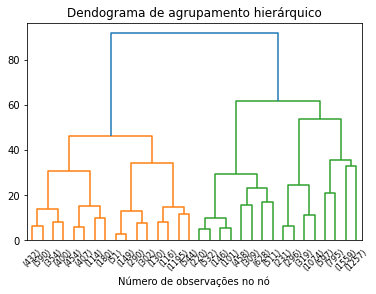

In [31]:
from scipy.cluster.hierarchy import dendrogram
def plot_dendrogram(model, **kwargs):
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack(
        [model.children_, model.distances_, counts]
    ).astype(float)

    dendrogram(linkage_matrix, **kwargs)

# Consultar a scikit para encontrar o método de agrupamento acumulativo
from scipy.cluster.hierarchy import dendrogram
from sklearn.cluster import AgglomerativeClustering

dend = AgglomerativeClustering(distance_threshold=0, n_clusters= None) # Chamada do método
dend = dend.fit(X)
plt.title("Dendograma de agrupamento hierárquico")
plot_dendrogram(dend, truncate_mode="level", p=4)
plt.xlabel("Número de observações no nó")
plt.show()

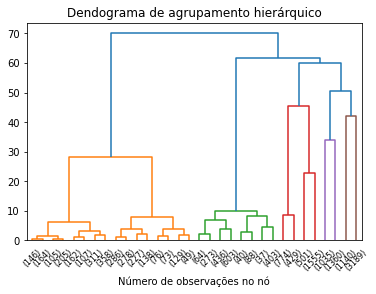

In [32]:
dend = dend.fit(X2)
plt.title("Dendograma de agrupamento hierárquico")
plot_dendrogram(dend, truncate_mode="level", p=4)
plt.xlabel("Número de observações no nó")
plt.show()

In [33]:
#import plotly.figure_factory as ff
#fig = ff.create_dendrogram(X)
#fig.update_layout(width=800, height=500)
#fig.show()

In [34]:
#dendogram = sch.dendrogram(sch.linkage(X, method="ward"))

In [35]:
#dendogram = sch.dendrogram(sch.linkage(X2, method="ward"))

In [36]:
n_clusters = 7

model = AgglomerativeClustering(n_clusters=n_clusters, affinity="euclidean", linkage="ward")
model.fit(X)
labels = model.labels_

In [37]:
base_df["cluster"] = labels
base_df.head()

,id,name,market_type,benchmark,strategy,risk,liquidity,is_income_tax_free,market,investor,return,volatility,sharpe,max_dd,var,minimum_application,cluster
0,RRRP3,3R PETROLEUM ÓLEO E GÁS S.A,Ações,IBOV,Renda Variável,4.0,2,False,Renda Variável,Público Geral,-0.131406,0.551172,-0.412630,-0.419996,0.076180,33.60,6
1,AERI3,AERIS IND. E COM. DE EQUIP. GERACAO DE ENERGIA...,Ações,IBOV,Renda Variável,4.0,2,False,Renda Variável,Público Geral,-0.609501,0.646211,-1.091786,-0.758763,0.085385,3.47,6
2,AESB3,AES BRASIL ENERGIA S.A.,Ações,IBOV,Renda Variável,4.0,2,False,Renda Variável,Público Geral,-0.213264,0.288464,-1.072189,-0.336788,0.038291,10.72,6
3,AFLT3,AFLUENTE TRANSMISSÃO DE ENERGIA ELÉTRICA S/A,Ações,IBOV,Renda Variável,4.0,2,False,Renda Variável,Público Geral,-0.017996,0.388144,-0.293757,-0.148004,0.056708,8.91,6
4,AGXY3,AGROGALAXY PARTICIPAÇÕES S.A.,Ações,IBOV,Renda Variável,4.0,2,False,Renda Variável,Público Geral,-0.139182,0.611407,-0.384696,-0.445000,0.075715,7.86,6


In [38]:
from sklearn.decomposition import PCA

pca = PCA(n_components=3)
pca.fit(X)
groups = pca.transform(X)
groups.shape
groups_df = pd.DataFrame(groups).loc[:,:2]
groups_df.columns = ["PC1", "PC2", "PC3"]
groups_df.head()

,PC1,PC2,PC3
0,0.235918,-0.012634,-0.504028
1,0.293153,-0.104900,-0.475870
2,0.177701,0.094935,-0.506706
3,0.136961,0.124111,-0.480181
4,0.240700,-0.020393,-0.503735


In [43]:
def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>  '''))
  init_notebook_mode(connected=False)
  
  
from plotly.offline import init_notebook_mode
enable_plotly_in_cell()
init_notebook_mode(connected=False)

import plotly.offline as py
import plotly.graph_objs as go

trace1 = go.Scatter3d(
    x=groups_df["PC1"],
    y=groups_df["PC2"],
    z=groups_df["PC3"],
    mode='markers',
    text= labels,
    marker=dict(
        size=2,
        color= labels,         
        colorscale=[[0.0,"indianred"],[0.2,"darkorange"],[0.4,"yellow"],[0.6,"mediumseagreen"],[0.8,"skyblue"],[1.0, "indigo"]],
        opacity=0.8
    )
)

data = [trace1]
layout = go.Layout(
    showlegend=False,
    title="Agrupamento clustering",
    scene = dict(
        xaxis = dict(title="PC1"),
        yaxis = dict(title="PC2"),
        zaxis = dict(title="PC3")
    ),
    width=800,
    height=800
)
fig = go.Figure(data=data, layout=layout)
py.iplot(fig, filename='3d-scatter-colorscale')

In [44]:
n_clusters = 7

model = AgglomerativeClustering(n_clusters=n_clusters, affinity="euclidean", linkage="ward")
model.fit(X2)
labels = model.labels_

In [45]:
base_df["cluster"] = labels
base_df.head()

,id,name,market_type,benchmark,strategy,risk,liquidity,is_income_tax_free,market,investor,return,volatility,sharpe,max_dd,var,minimum_application,cluster
0,RRRP3,3R PETROLEUM ÓLEO E GÁS S.A,Ações,IBOV,Renda Variável,4.0,2,False,Renda Variável,Público Geral,-0.131406,0.551172,-0.412630,-0.419996,0.076180,33.60,0
1,AERI3,AERIS IND. E COM. DE EQUIP. GERACAO DE ENERGIA...,Ações,IBOV,Renda Variável,4.0,2,False,Renda Variável,Público Geral,-0.609501,0.646211,-1.091786,-0.758763,0.085385,3.47,0
2,AESB3,AES BRASIL ENERGIA S.A.,Ações,IBOV,Renda Variável,4.0,2,False,Renda Variável,Público Geral,-0.213264,0.288464,-1.072189,-0.336788,0.038291,10.72,0
3,AFLT3,AFLUENTE TRANSMISSÃO DE ENERGIA ELÉTRICA S/A,Ações,IBOV,Renda Variável,4.0,2,False,Renda Variável,Público Geral,-0.017996,0.388144,-0.293757,-0.148004,0.056708,8.91,0
4,AGXY3,AGROGALAXY PARTICIPAÇÕES S.A.,Ações,IBOV,Renda Variável,4.0,2,False,Renda Variável,Público Geral,-0.139182,0.611407,-0.384696,-0.445000,0.075715,7.86,0


In [46]:
from sklearn.decomposition import PCA

pca = PCA(n_components=3)
pca.fit(X2)
groups = pca.transform(X2)
groups.shape
groups_df = pd.DataFrame(groups).loc[:,:2]
groups_df.columns = ["PC1", "PC2", "PC3"]
groups_df.head()

,PC1,PC2,PC3
0,0.319073,-0.302381,-0.025138
1,0.339366,-0.319382,-0.026247
2,0.300650,-0.281620,-0.022945
3,0.289761,-0.272795,-0.021414
4,0.320716,-0.304111,-0.025328


In [47]:
def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>  '''))
  init_notebook_mode(connected=False)
  
  
from plotly.offline import init_notebook_mode
enable_plotly_in_cell()
init_notebook_mode(connected=False)

import plotly.offline as py
import plotly.graph_objs as go

trace1 = go.Scatter3d(
    x=groups_df["PC1"],
    y=groups_df["PC2"],
    z=groups_df["PC3"],
    mode='markers',
    text= labels,
    marker=dict(
        size=2,
        color= labels,         
        colorscale=[[0.0,"indianred"],[0.2,"darkorange"],[0.4,"yellow"],[0.6,"mediumseagreen"],[0.8,"skyblue"],[1.0, "indigo"]],
        opacity=0.8
    )
)

data = [trace1]
layout = go.Layout(
    showlegend=False,
    title="Agrupamento clustering",
    scene = dict(
        xaxis = dict(title="PC1"),
        yaxis = dict(title="PC2"),
        zaxis = dict(title="PC3")
    ),
    width=800,
    height=800
)
fig = go.Figure(data=data, layout=layout)
py.iplot(fig, filename='3d-scatter-colorscale')